## Import of required libraries

In [ ]:
!pip install ultralytics
!pip install pytesseract
!apt-get install tesseract-ocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 715.0/715.0 kB 4.3 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 33 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (3,614 kB/s)
Selecting previously unselected package tesseract-ocr-eng.
(Reading database ... 121749 

In [ ]:
import cv2
import matplotlib.pyplot as plt
import pytesseract
import os
import shutil
import pandas as pd
import numpy as np

from PIL import Image
from pytesseract import Output
from ultralytics import SAM
from ultralytics import YOLO

## Library

In [ ]:
class TextDetector():
    def __init__(self):
        self.lang = 'eng' # Need to load fra or any other language subpackage

    def extractText(self, img = None):
        string_ocr = pytesseract.image_to_string(img, lang=self.lang, config='--psm 6')
        return string_ocr

    def highlightText(self, img_src = None, conf = 30):
        # Extract all text and meta data as dictionary
        data_ocr = pytesseract.image_to_data(img_src, lang=self.lang, config='--psm 6', output_type=Output.DICT)
        # Copy source image to draw rectangles
        img_result = img_src.copy()
        # Iterate through all words
        for i in range(len(data_ocr['text'])):
            # Skip other levels than 5 (word)
            if data_ocr['level'][i] != 5 or len(data_ocr['text'][i]) == 0 or data_ocr['conf'][i] <= conf:
                continue
            # Get bounding box position and size of word
            (x, y, w, h) = (data_ocr['left'][i], data_ocr['top'][i], data_ocr['width'][i], data_ocr['height'][i])
            # Draw rectangle for word bounding box
            cv2.rectangle(img_result, (x, y), (x + w, y + h), (255,0,0), 1)

        return img_result, data_ocr

In [ ]:
class YoloDetector:
    def __init__(self, size = 'm', path = None):
        if path is not None:
          self.model = YOLO(path)
        else:
          self.model = YOLO(f'yolov8{size}.pt')

    def train(self, yaml_file, epochs=100):
        results = self.model.train(data=yaml_file, epochs=epochs)
        metrics = self.model.val()
        return results, metrics

    def predict(self, img, visualize = True):
        r = self.model(img)
        if visualize:
          plt.figure(figsize=(8, 10))
          plt.imshow(r[0].plot())
          plt.show()
        return r

    def save(self, path):
        self.model.save(path)

In [ ]:
# Define the function to calculate the Intersection over Union (IoU) of two boxes
def bb_intersection_over_union(boxA, boxB):
    # Determine the coordinates of the intersection rectangle
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    # Compute the area of intersection rectangle
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)

    # Compute the area of both the prediction and ground-truth rectangles
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)

    # Compute the intersection over union by taking the intersection area and dividing it by the sum of prediction + ground-truth areas - the interesection area
    iou = interArea / float(boxAArea + boxBArea - interArea)

    # Return the intersection over union value
    return iou

# Define the function to eliminate boxes that overlap with boxes in another array
def eliminate_overlapping_boxes(sbboxes, scores, ybboxes, iou_threshold=0.5):
    # List to keep track of boxes to keep
    filtered_boxes = []
    filtered_scores = []

    # Iterate over each box in sbboxes
    for i, sbbox in enumerate(sbboxes):
        keep_box = True
        # Check for overlap with each box in ybboxes
        for ybbox in ybboxes:
            if bb_intersection_over_union(sbbox, ybbox) > iou_threshold:
                keep_box = False
                break
        # If box does not overlap, add it to the list of boxes to keep
        if keep_box:
            filtered_boxes.append(sbbox)
            filtered_scores.append(scores[i])

    return np.array(filtered_boxes), np.array(filtered_scores)

In [ ]:
def plot_boxes(img, bboxes, classes, scores, color = (255, 255, 255)):
    for bbox, cls, score in zip(bboxes, classes, scores):
        # Draw a rectangle around the box
        (x1, y1, x2, y2) = map(int, bbox)
        # print(bbox[0])
        cv2.rectangle(img, (x1, y1), (x2, y2), (0, 0, 0), 2)


        # Set the background color and text size
        background_color = (255, 0, 0)
        text = f'{cls} {score:.2f}'
        font_scale = 0.6
        font_thickness = 1

        # Get the width and height of the text box
        (text_width, text_height), baseline = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, font_scale, font_thickness)

        # Draw the filled rectangle (background of the text)
        cv2.rectangle(img, (x1, y1 - text_height), (x1 + text_width, y1), background_color, -1)

        # cv2.putText(img, f'{cls} {score:.2f}', (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, .5, (0, 0, 0), 1, cv2.LINE_AA, bgColour=(255, 0, 0))
        cv2.putText(img, text, (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, font_scale, color, font_thickness, cv2.LINE_AA)

    return img

def plot_img(img):
    plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.axis('off')  # Hide the axis
    plt.show()

In [ ]:
def inference(paths, custom_image_dir):
    img_path = [os.path.join(custom_image_dir, _) for _ in paths];
    img_test = [cv2.imread(_) for _ in img_path]
    img_test = [cv2.cvtColor(_, cv2.COLOR_BGR2RGB) for _ in img_test]
    yresults = yl.predict([i.copy() for i in img_test], visualize=False)


    for i, y, p, id in zip(img_test, yresults, paths, range(len(paths))):
      s = sam_model(i.copy())[0]

      ybboxes = np.array(y.boxes.xyxy.cpu())
      yscores = np.array(y.boxes.conf.cpu())

      ycls = np.array(y.boxes.cls.cpu())
      ycls = [targets[int(_)] for _ in ycls]

      s_bboxes, s_scores = eliminate_overlapping_boxes(np.array(s.boxes.xyxy.cpu()), np.array(s.boxes.conf.cpu()), ybboxes, 0.1)

      print(f"/_____________________________/")
      print(f"Fichier {id}: {p}")
      print("\n")
      print(f"Affichage de la detection des classes par YOLO")
      print("\n")
      ploted_img = plot_boxes(i.copy(), ybboxes, ycls, yscores)
      plot_img(ploted_img)

      print("\n")
      print("\n")
      print(f"Affichage de la detection de forme par SAM")
      print("\n")
      ploted_img = plot_boxes(ploted_img, s_bboxes, [''] * len(s_bboxes), s_scores)
      plot_img(ploted_img)


In [ ]:
yaml_file = '/content/conf.yaml'
epochs = 6
targets = ['Barcode', 'Logo', 'Qrcode', 'Texte']

## Training

In [ ]:
# Load a SAM model
sam_model = SAM('sam_b.pt')

# Initiation du modele YOLOv8
yl = YoloDetector()

100%|██████████| 358M/358M [00:02<00:00, 144MB/s]


100%|██████████| 49.7M/49.7M [00:00<00:00, 127MB/s]


In [ ]:
# Entrainement du modele Yolo
results, metrics = yl.train(yaml_file, epochs=epochs)

Ultralytics YOLOv8.1.14 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/conf.yaml, epochs=6, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True

100%|██████████| 755k/755k [00:00<00:00, 19.4MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 79.6MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/DataSets/products_packaging/train/labels.cache... 191 images, 0 backgrounds, 0 corrupt: 100%|██████████| 191/191 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/MyDrive/DataSets/products_packaging/val/labels.cache... 77 images, 0 backgrounds, 0 corrupt: 100%|██████████| 77/77 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 6 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/6      6.87G      1.916      3.403      1.686        218        640: 100%|██████████| 12/12 [00:14<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.45s/it]

                   all         77        491      0.248      0.424      0.234      0.112



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/6      7.07G       1.36      1.716       1.25        170        640: 100%|██████████| 12/12 [00:06<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.61it/s]

                   all         77        491      0.534      0.481      0.486      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/6      7.06G      1.346      1.519      1.225        200        640: 100%|██████████| 12/12 [00:06<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.42it/s]


                   all         77        491      0.527      0.361      0.396      0.245

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/6      7.08G      1.264      1.373      1.221        183        640: 100%|██████████| 12/12 [00:06<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]

                   all         77        491      0.506      0.566      0.424      0.248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/6      7.08G      1.262      1.259      1.215        191        640: 100%|██████████| 12/12 [00:06<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.71it/s]

                   all         77        491      0.601      0.592      0.588      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/6      7.05G      1.218       1.17      1.178        188        640: 100%|██████████| 12/12 [00:06<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.63it/s]

                   all         77        491       0.71       0.65      0.674      0.423



6 epochs completed in 0.022 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.1.14 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25842076 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.21it/s]


                   all         77        491       0.71      0.648      0.674      0.423
               Barcode         77         17      0.846      0.647      0.823      0.471
                  Logo         77         90      0.573      0.478      0.536      0.293
                Qrcode         77          5      0.907        0.8      0.796      0.641
                 Texte         77        379      0.516      0.668      0.542      0.289
Speed: 0.3ms preprocess, 10.6ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs/detect/train
Ultralytics YOLOv8.1.14 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25842076 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/MyDrive/DataSets/products_packaging/val/labels.cache... 77 images, 0 backgrounds, 0 corrupt: 100%|██████████| 77/77 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:08<00:00,  1.78s/it]


                   all         77        491      0.707      0.649      0.676      0.423
               Barcode         77         17       0.85      0.666      0.824      0.469
                  Logo         77         90      0.561      0.467       0.54      0.291
                Qrcode         77          5      0.896        0.8      0.796      0.641
                 Texte         77        379      0.521      0.665      0.543      0.292
Speed: 0.4ms preprocess, 35.5ms inference, 0.0ms loss, 18.7ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
# shutil.make_archive('./model_result', 'zip', '/content/runs/detect')

### Performances on fine-tunning

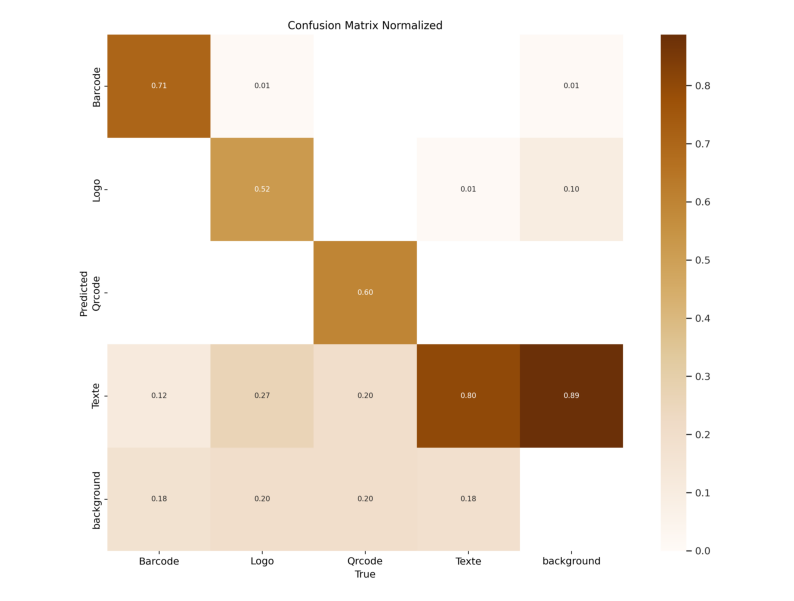

In [ ]:
plot_img(cv2.imread("/content/runs/detect/train2/confusion_matrix_normalized.png"))

## Inference

### Load images for inference

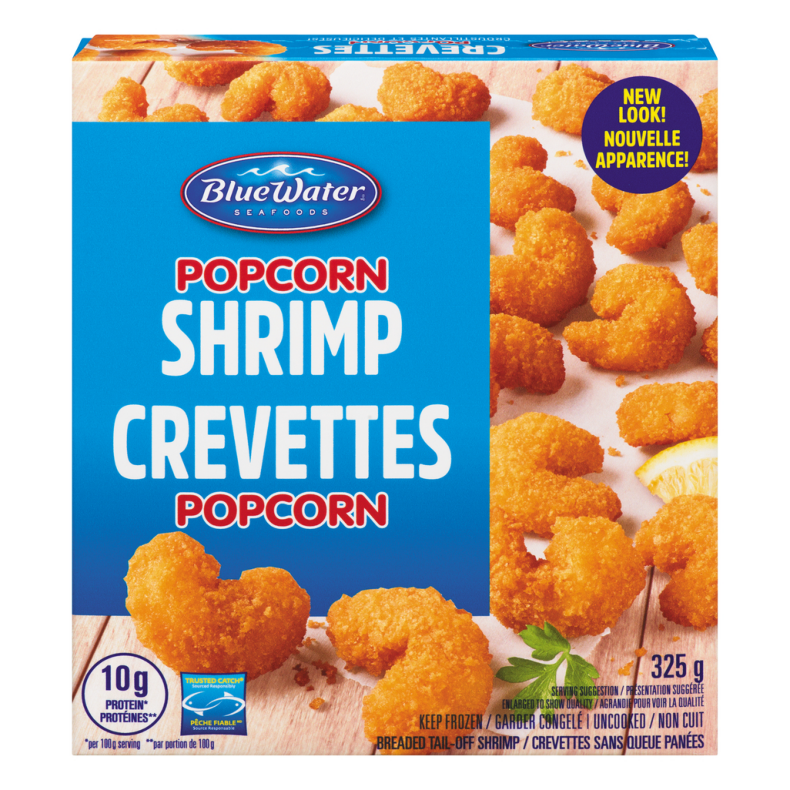

In [ ]:
# Define the directory where the custom images are stored
custom_image_dir = '/content/drive/MyDrive/DataSets/products_packaging/test/images'

# Get the list of image files in the directory
image_files = os.listdir(custom_image_dir)

img_path = os.path.join(custom_image_dir, image_files[4]);
img_test = cv2.imread(img_path)
img_test = cv2.cvtColor(img_test, cv2.COLOR_BGR2RGB)
plot_img(img_test)

### Text detection using Pytesseract

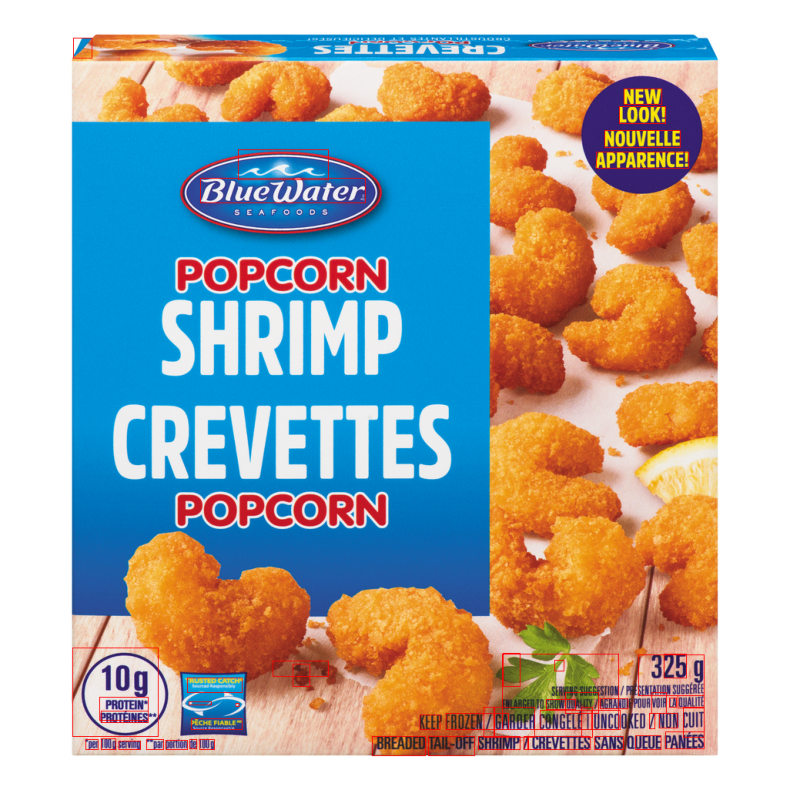

In [ ]:
textDetector = TextDetector()
img_wt, r = textDetector.highlightText(img_test, -1)
plot_img(img_wt)

### Prediction using Yolo and Sam model


0: 640x640 3 Logos, 20 Textes, 37.2ms
Speed: 3.3ms preprocess, 37.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


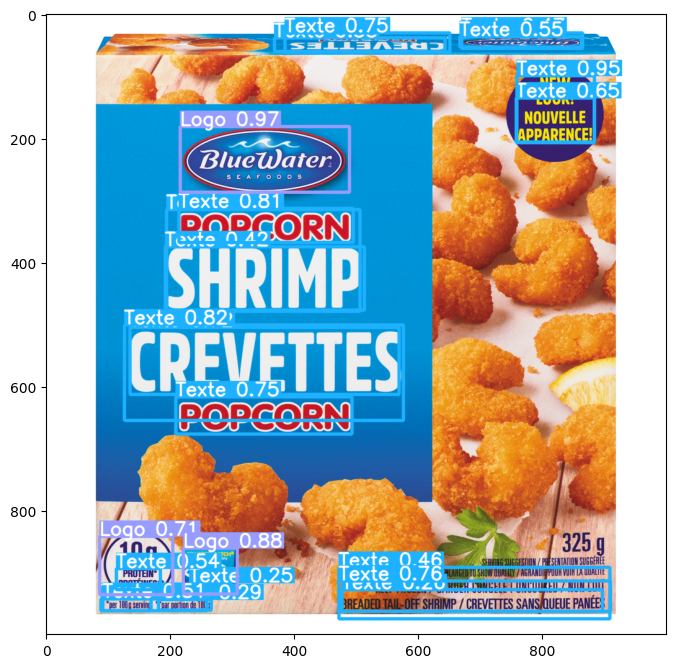

In [ ]:
# Run object detection on the image
yresults = yl.predict(img_test.copy(), visualize=True)

/usr/local/lib/python3.10/dist-packages/ultralytics/models/sam/modules/encoders.py:321: UserWarning: cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:71.)
  y_embed = grid.cumsum(dim=0) - 0.5
/usr/local/lib/python3.10/dist-packages/ultralytics/models/sam/modules/encoders.py:322: UserWarning: cumsum_cuda_kernel does not have a deterministic implementation, but you set 'torch.use_deterministic_algorithms(True, warn_only=True)'. You can file an issue at https://github.com/pytorch/pytorch/issues to help us prioritize adding deterministic support for this operation. (Triggered internally at ../aten/src/ATen/Context.cpp:71.)
  x_embed = grid.cumsum(dim=1) - 0.5


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 1 57, 1 58, 1 59, 1 60, 1 61, 1 62, 1 63, 1 64, 1 65, 1 66, 1 67, 1 68, 1 69, 1 70, 1 71, 1 72, 1 73, 1 74, 1 75, 1 76, 1 77, 1 78, 1 79, 1 80, 1 81, 1 82, 1 83, 1 84, 1 85, 1 86, 1 87, 1 88, 1 89, 1 90, 1 91, 1 92, 1 93, 1 94, 1 95, 13708.7ms
Speed: 6.4ms preprocess, 13708.7ms inference, 80.5ms postprocess per image at shape (1, 3, 1024, 1024)


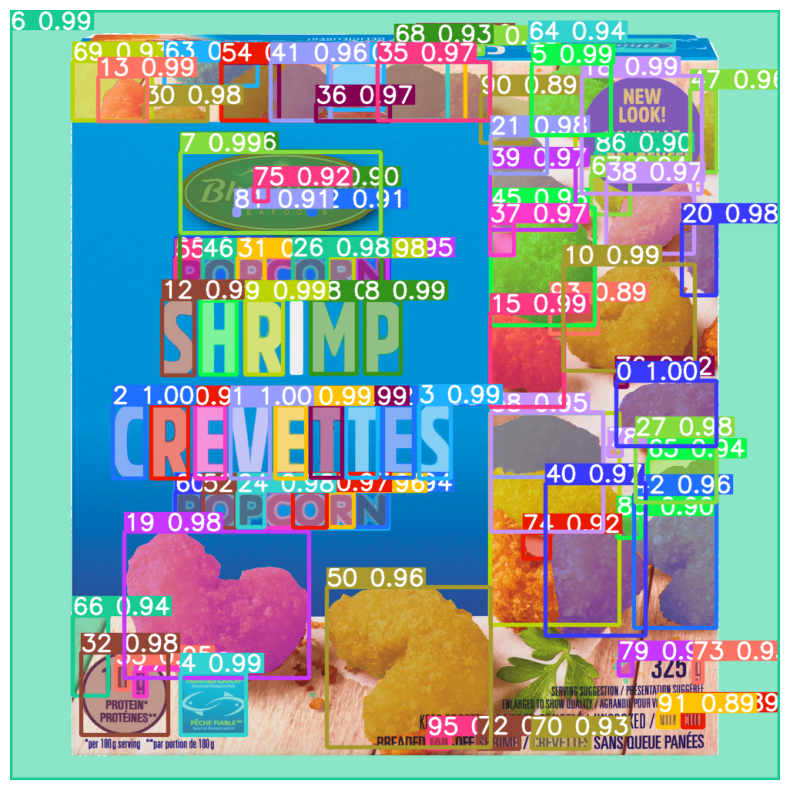

In [ ]:
sresults = sam_model(img_test.copy())
plot_img(sresults[0].plot())

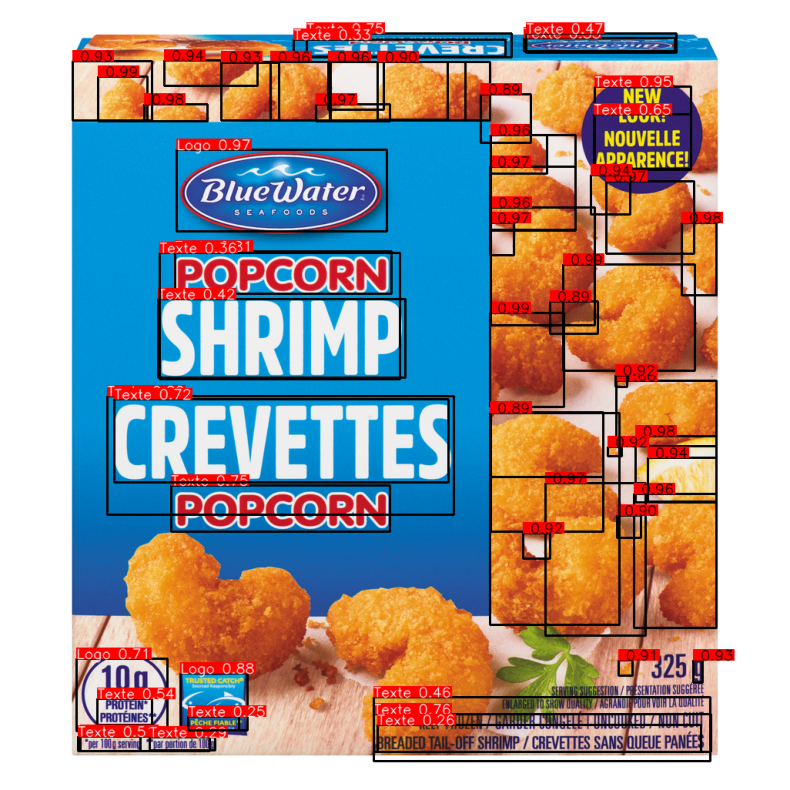

In [ ]:
ybboxes = np.array(yresults[0].boxes.xyxy.cpu())
yscores = np.array(yresults[0].boxes.conf.cpu())

ycls = np.array(yresults[0].boxes.cls.cpu())
ycls = [targets[int(_)] for _ in ycls]

s_bboxes, s_scores = eliminate_overlapping_boxes(np.array(sresults[0].boxes.xyxy.cpu()), np.array(sresults[0].boxes.conf.cpu()), ybboxes, 0)

ploted_img = plot_boxes(img_test.copy(), ybboxes, ycls, yscores)
ploted_img = plot_boxes(ploted_img, s_bboxes, [''] * len(s_bboxes), s_scores, (0, 0, 0))
plot_img(ploted_img)


0: 640x640 1 Barcode, 1 Logo, 28 Textes, 1: 640x640 1 Logo, 19 Textes, 2: 640x640 3 Logos, 15 Textes, 3: 640x640 2 Logos, 11 Textes, 4: 640x640 3 Logos, 20 Textes, 5: 640x640 1 Logo, 18 Textes, 6: 640x640 2 Logos, 8 Textes, 7: 640x640 1 Barcode, 1 Logo, 7 Textes, 8: 640x640 5 Logos, 1 Qrcode, 11 Textes, 9: 640x640 1 Qrcode, 2 Textes, 10: 640x640 12 Textes, 304.1ms
Speed: 3.2ms preprocess, 27.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 13697.3ms
Speed: 6.2ms preprocess, 13697.3ms inference, 20.4ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 0: fbf168de-BibigoBack.PNG


Afficha

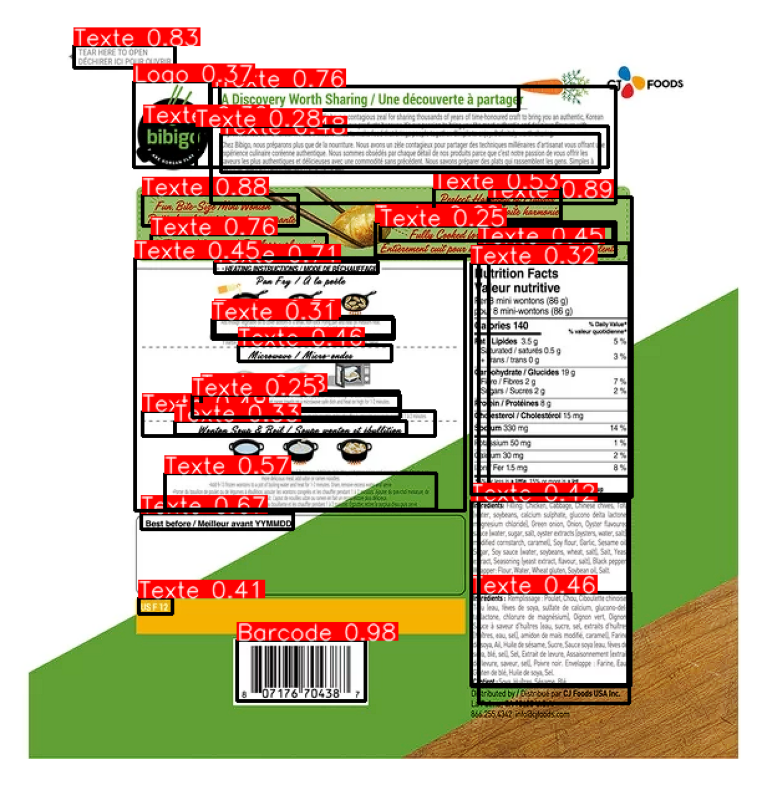





Affichage de la detection de forme par SAM




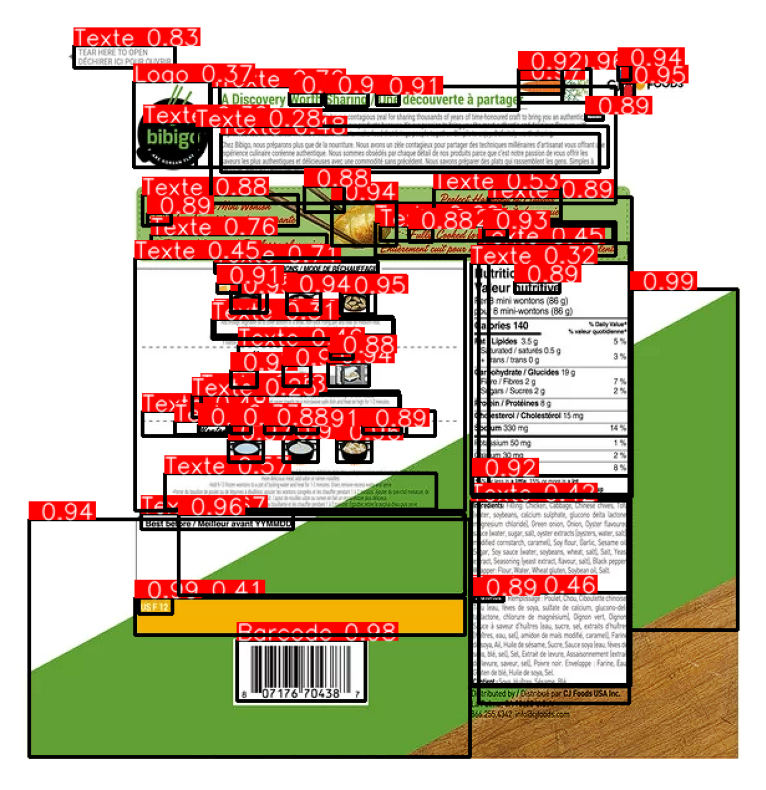


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 1 57, 1 58, 1 59, 1 60, 1 61, 1 62, 1 63, 1 64, 1 65, 1 66, 13948.1ms
Speed: 5.4ms preprocess, 13948.1ms inference, 9.7ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 1: feb96e84-5.PNG


Affichage de la detection des classes par YOLO




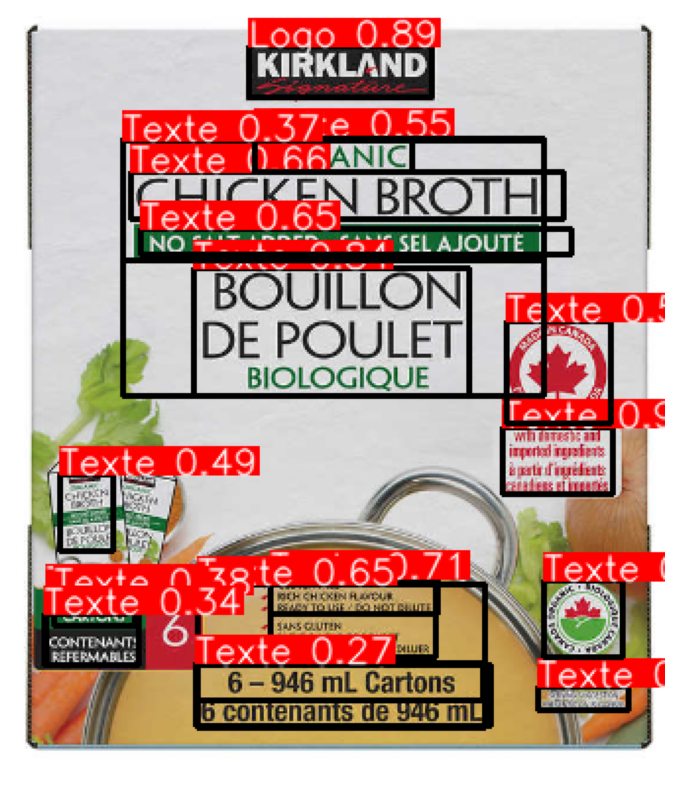





Affichage de la detection de forme par SAM




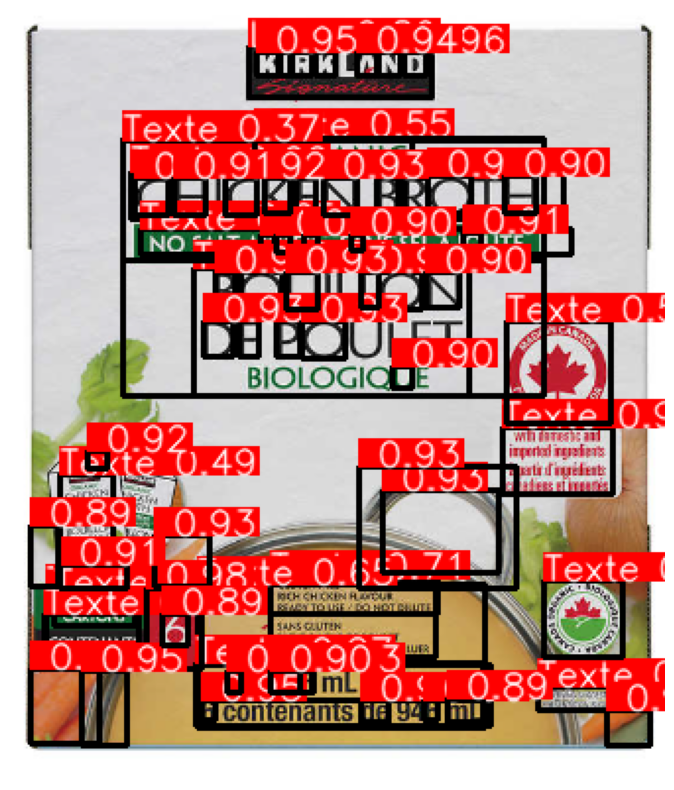


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 1 57, 1 58, 1 59, 1 60, 1 61, 1 62, 1 63, 1 64, 1 65, 13733.2ms
Speed: 5.6ms preprocess, 13733.2ms inference, 19.5ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 2: fde28d0e-Chickapea.PNG


Affichage de la detection des classes par YOLO




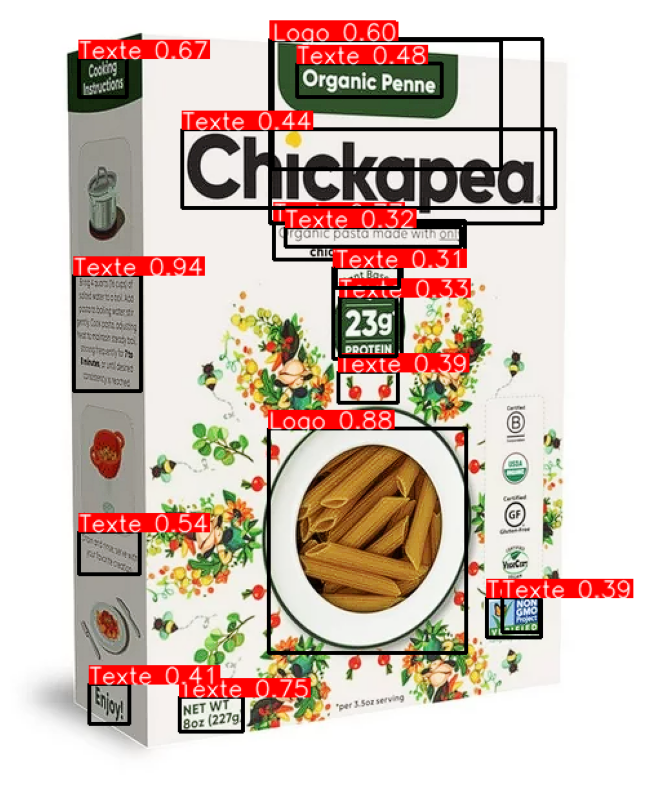





Affichage de la detection de forme par SAM




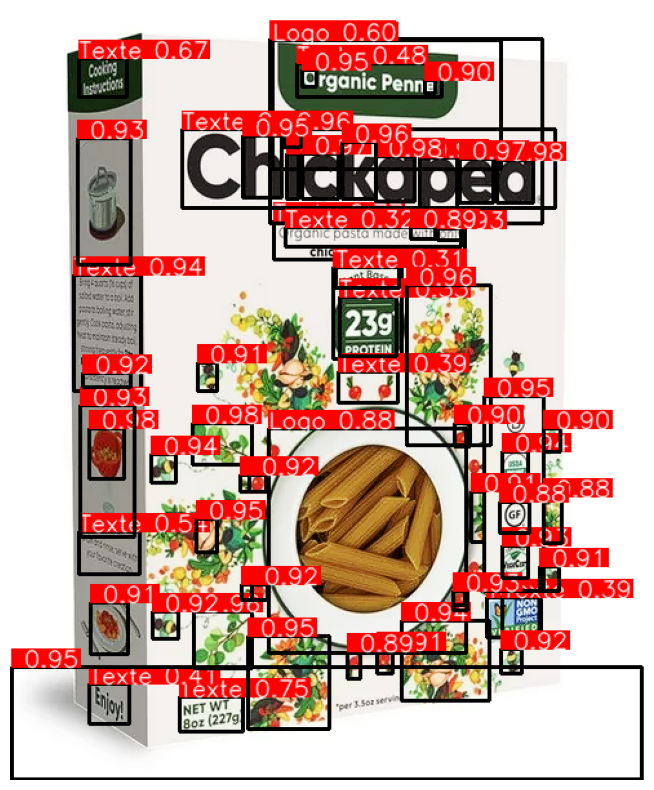


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 1 57, 1 58, 1 59, 1 60, 1 61, 1 62, 1 63, 1 64, 1 65, 1 66, 1 67, 1 68, 13622.8ms
Speed: 8.6ms preprocess, 13622.8ms inference, 57.4ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 3: 0083644303119.jpg


Affichage de la detection des classes par YOLO




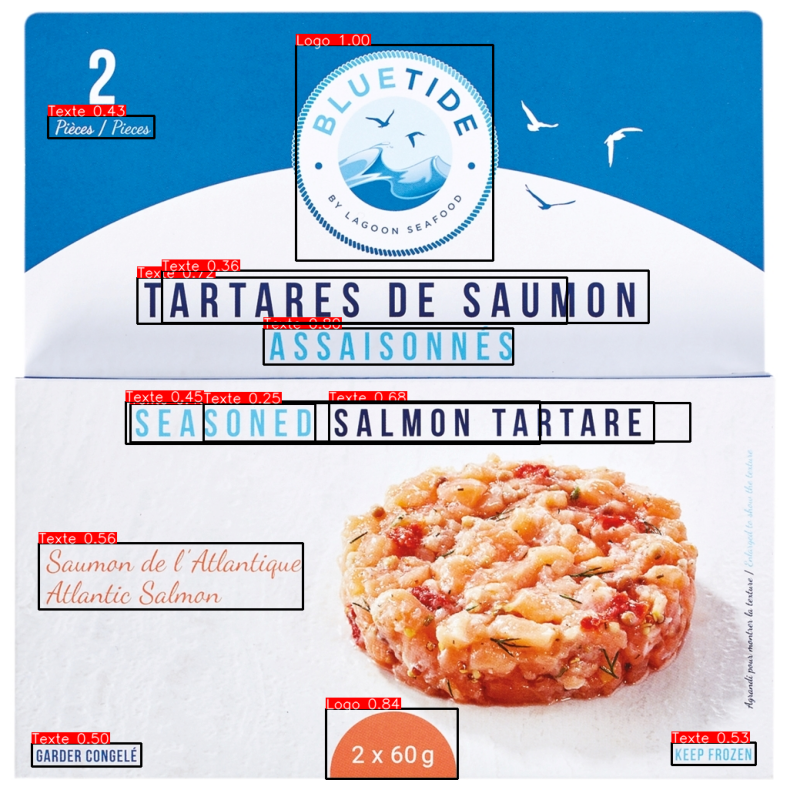





Affichage de la detection de forme par SAM




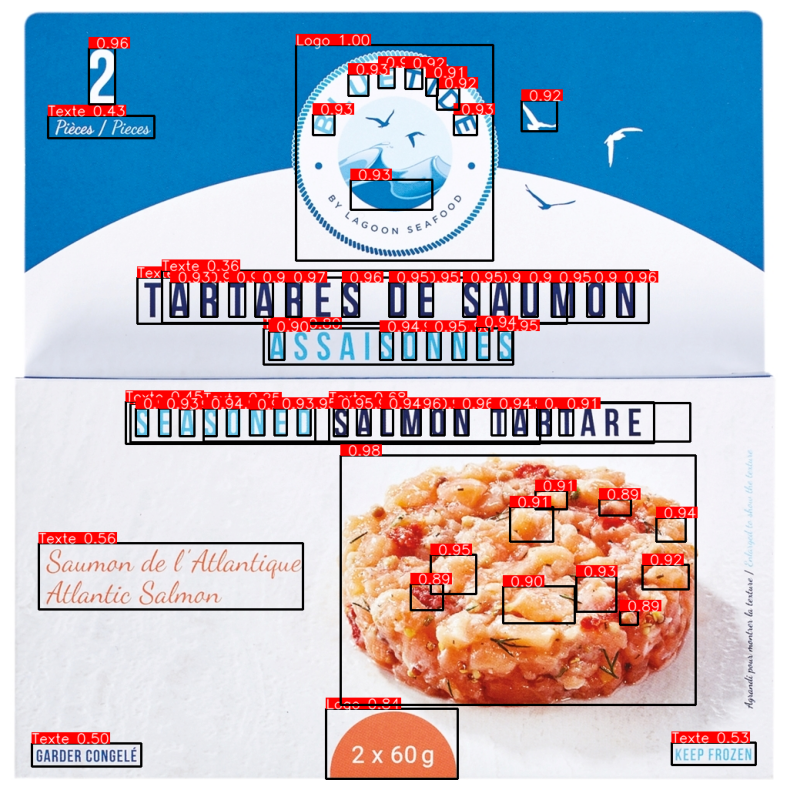


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 1 57, 1 58, 1 59, 1 60, 1 61, 1 62, 1 63, 1 64, 1 65, 1 66, 1 67, 1 68, 1 69, 1 70, 1 71, 1 72, 1 73, 1 74, 1 75, 1 76, 1 77, 1 78, 1 79, 1 80, 1 81, 1 82, 1 83, 1 84, 1 85, 1 86, 1 87, 1 88, 1 89, 1 90, 1 91, 1 92, 1 93, 1 94, 1 95, 13462.3ms
Speed: 6.0ms preprocess, 13462.3ms inference, 78.7ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 4: 0006221815309.jpg


Affichage de la detection des classes par YOLO




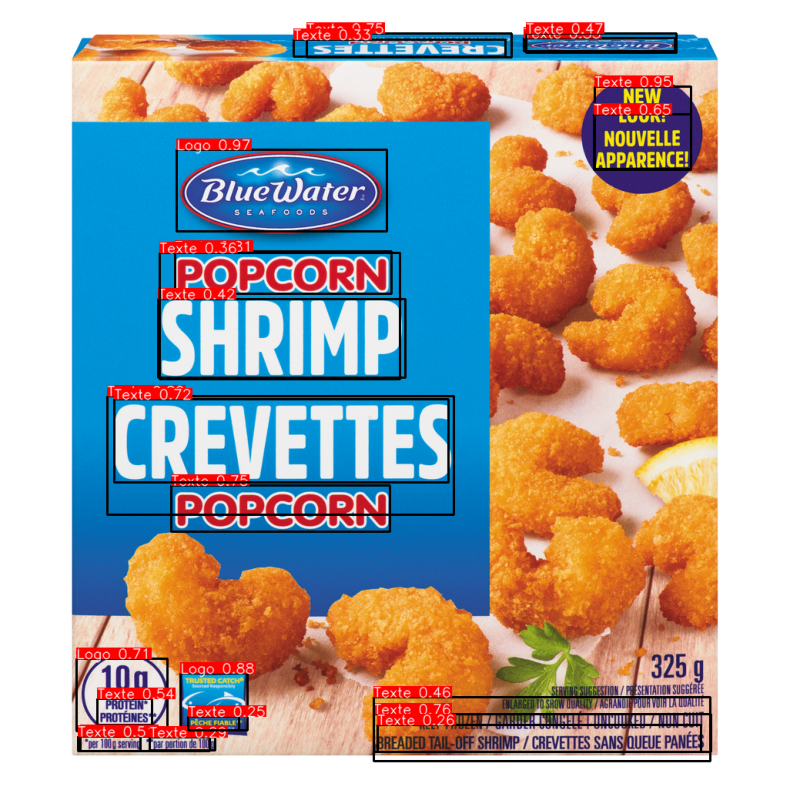





Affichage de la detection de forme par SAM




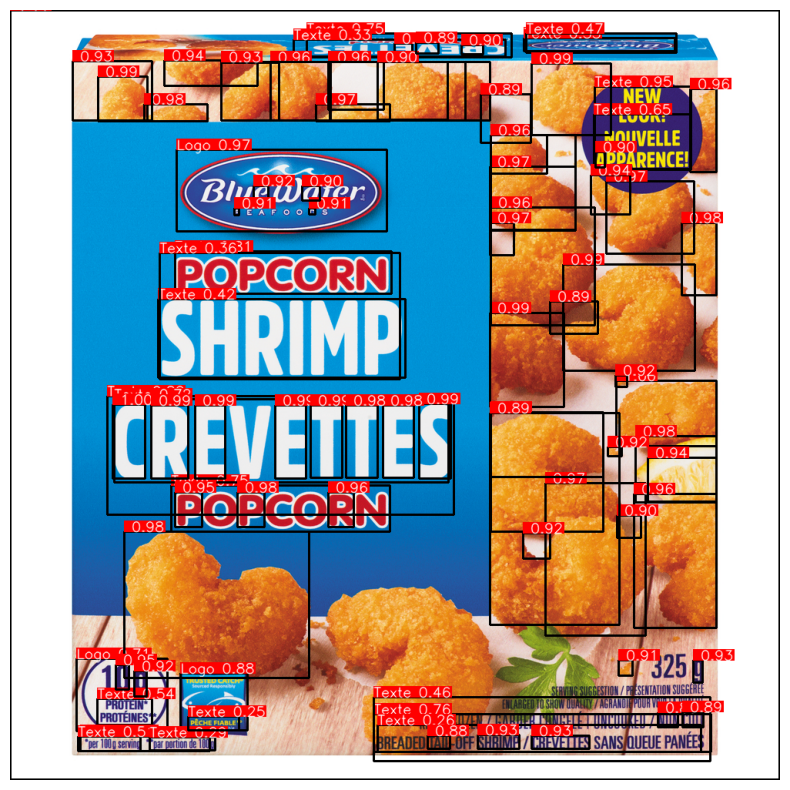


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 13558.4ms
Speed: 8.5ms preprocess, 13558.4ms inference, 43.4ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 5: 0062801146205.jpg


Affichage de la detection des classes par YOLO




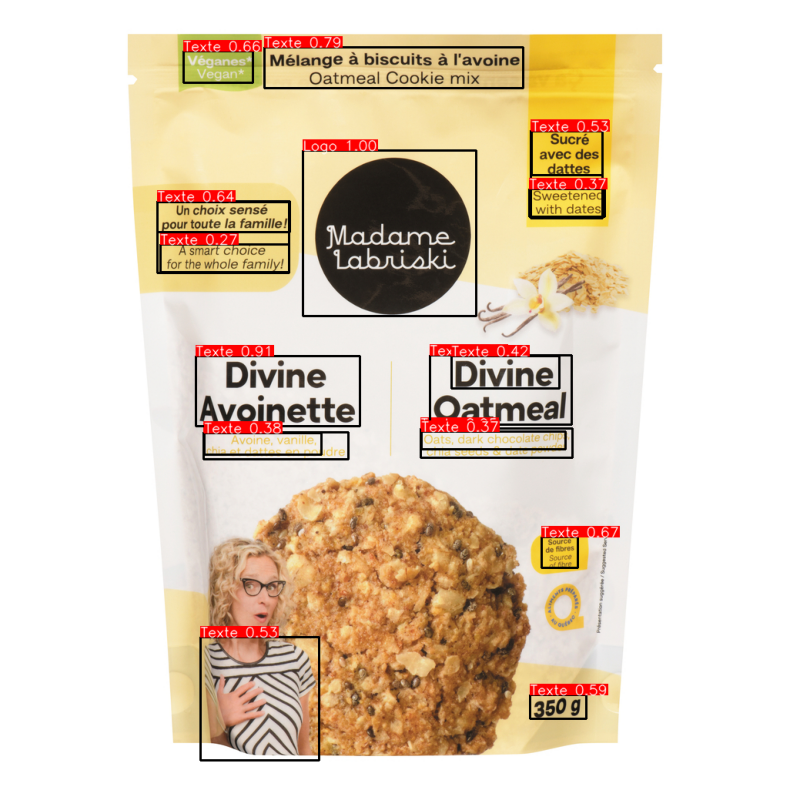





Affichage de la detection de forme par SAM




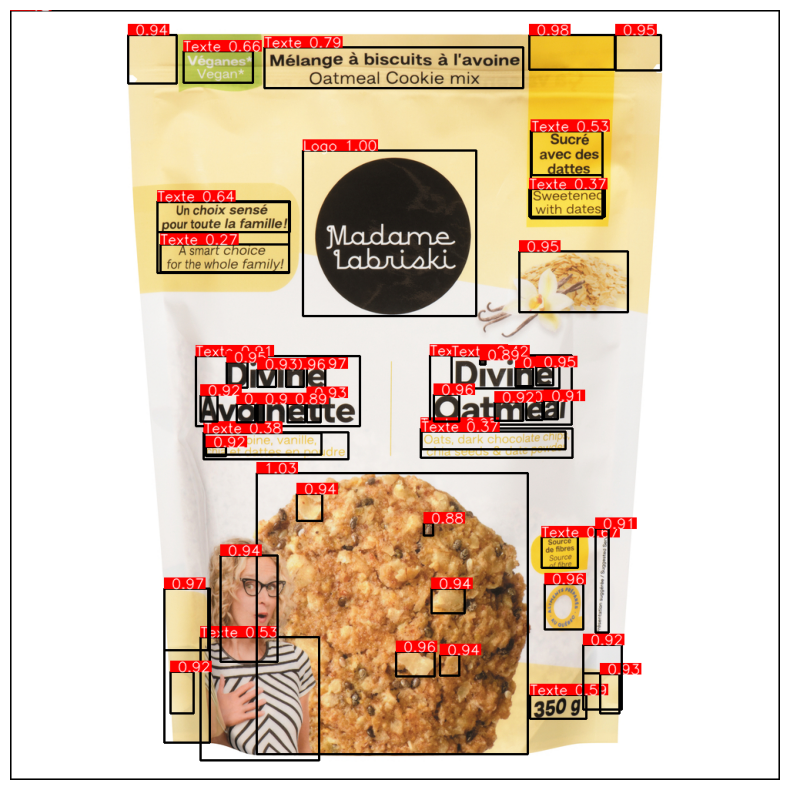


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 13675.4ms
Speed: 8.7ms preprocess, 13675.4ms inference, 29.6ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 6: 0062821400140.jpg


Affichage de la detection des classes par YOLO




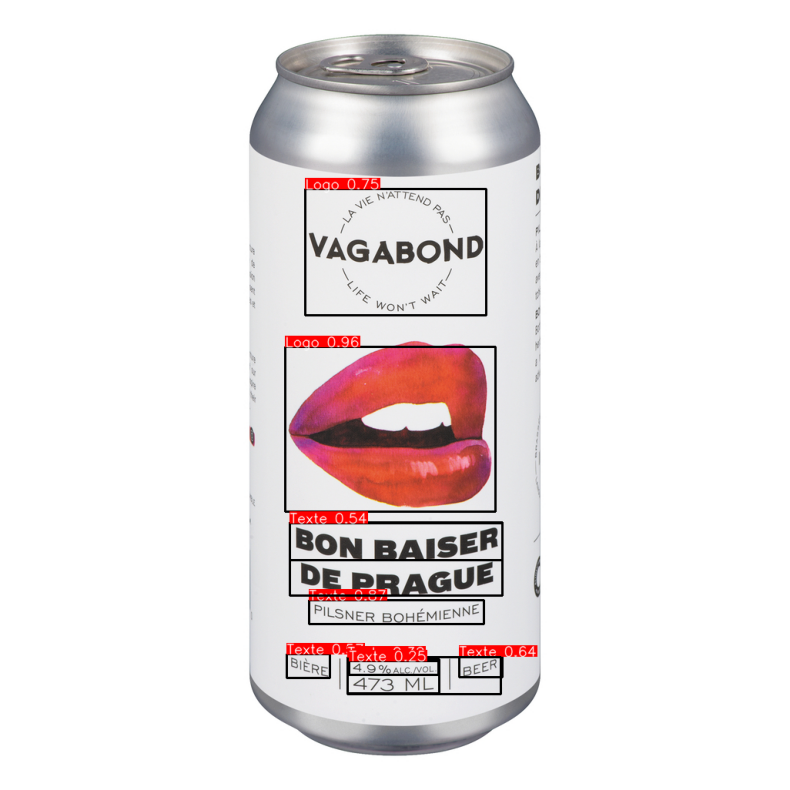





Affichage de la detection de forme par SAM




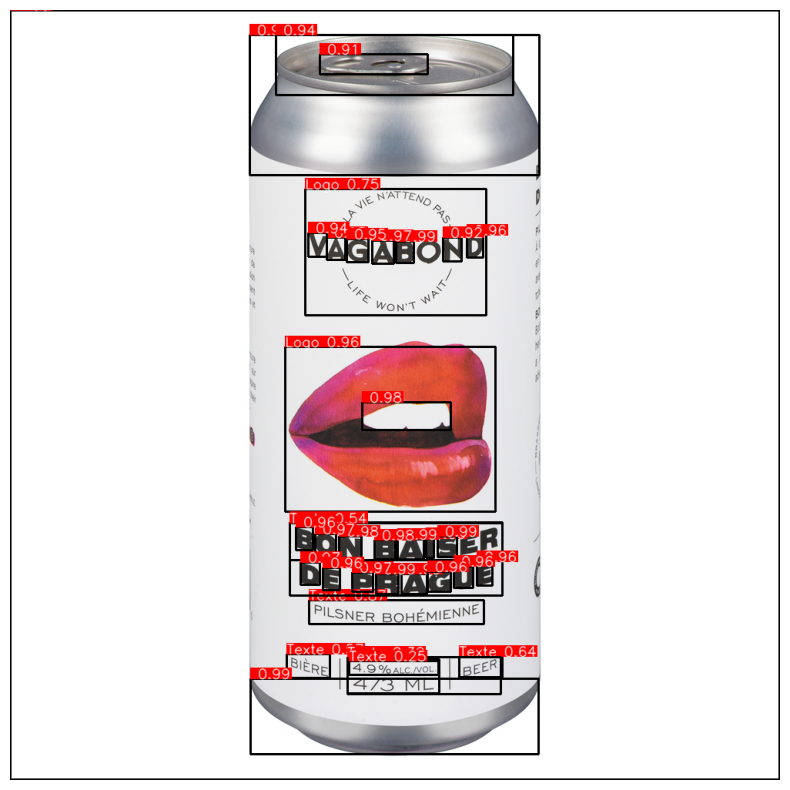


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 13355.1ms
Speed: 4.6ms preprocess, 13355.1ms inference, 2.1ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 7: téléchargement.jpeg


Affichage de la detection des classes par YOLO




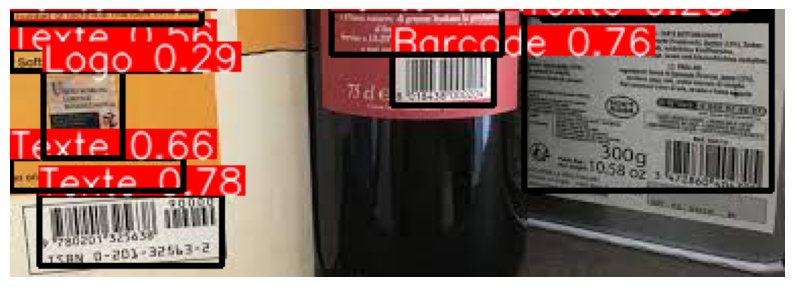





Affichage de la detection de forme par SAM




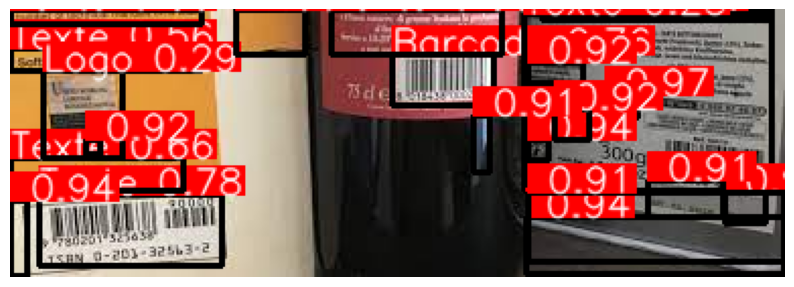


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 13674.3ms
Speed: 5.8ms preprocess, 13674.3ms inference, 12.8ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 8: productpackaging-01.png


Affichage de la detection des classes par YOLO




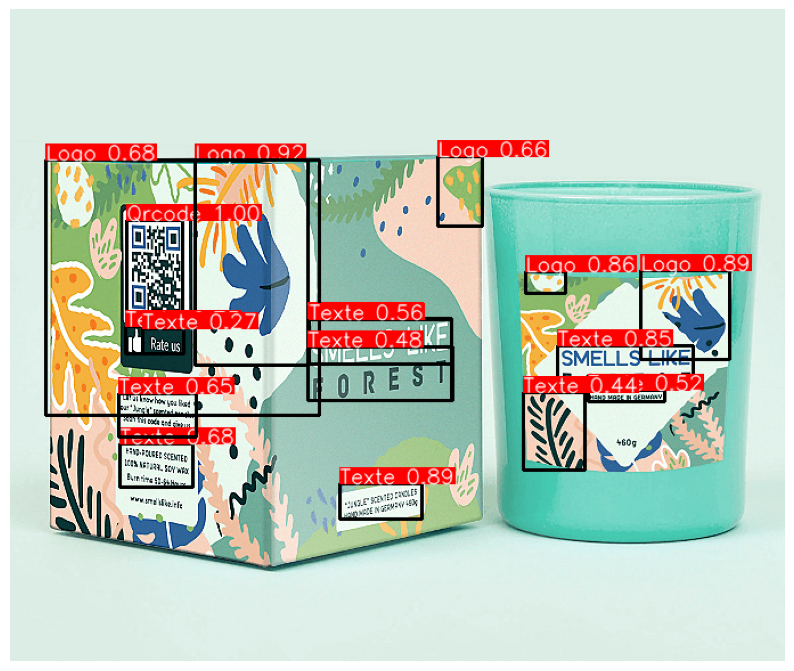





Affichage de la detection de forme par SAM




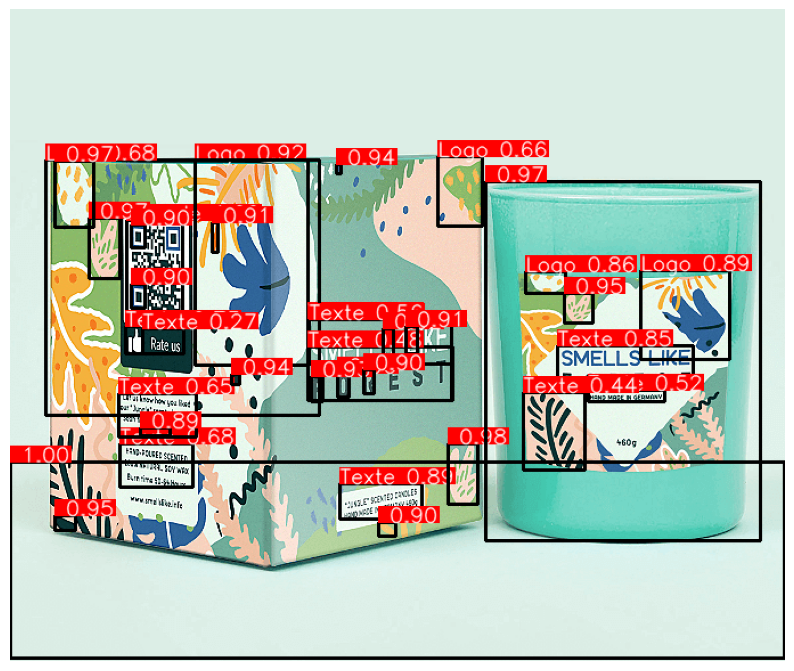


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 13459.0ms
Speed: 4.6ms preprocess, 13459.0ms inference, 2.3ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 9: images.jpeg


Affichage de la detection des classes par YOLO




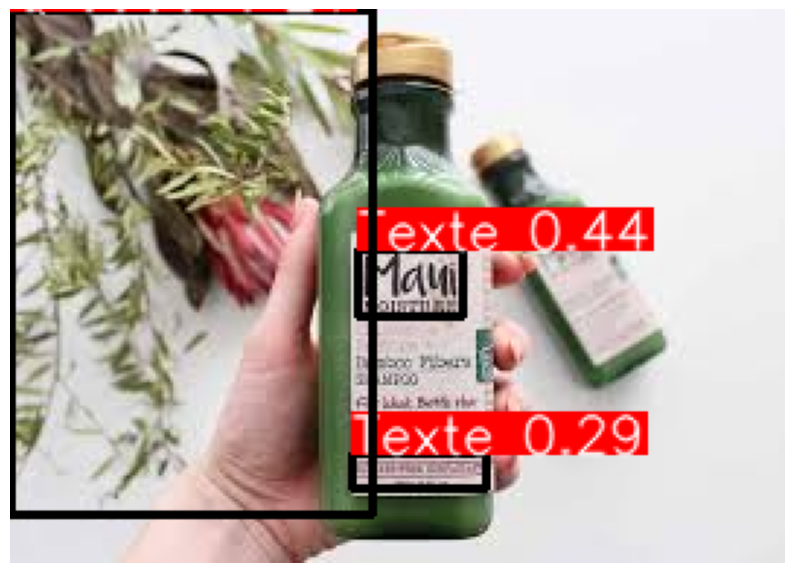





Affichage de la detection de forme par SAM




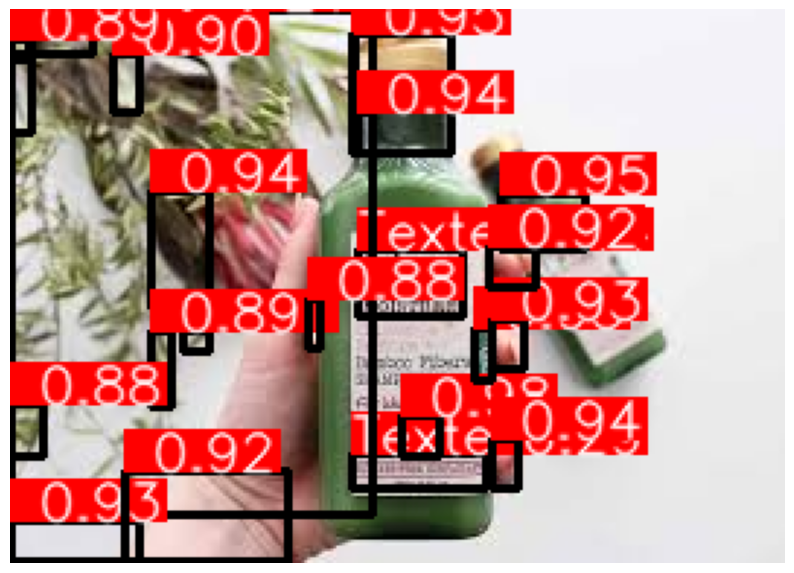


0: 1024x1024 1 0, 1 1, 1 2, 1 3, 1 4, 1 5, 1 6, 1 7, 1 8, 1 9, 1 10, 1 11, 1 12, 1 13, 1 14, 1 15, 1 16, 1 17, 1 18, 1 19, 1 20, 1 21, 1 22, 1 23, 1 24, 1 25, 1 26, 1 27, 1 28, 1 29, 1 30, 1 31, 1 32, 1 33, 1 34, 1 35, 1 36, 1 37, 1 38, 1 39, 1 40, 1 41, 1 42, 1 43, 1 44, 1 45, 1 46, 1 47, 1 48, 1 49, 1 50, 1 51, 1 52, 1 53, 1 54, 1 55, 1 56, 1 57, 1 58, 1 59, 1 60, 1 61, 13454.2ms
Speed: 5.5ms preprocess, 13454.2ms inference, 12.9ms postprocess per image at shape (1, 3, 1024, 1024)
/_____________________________/
Fichier 10: scanner-progress-min.png


Affichage de la detection des classes par YOLO




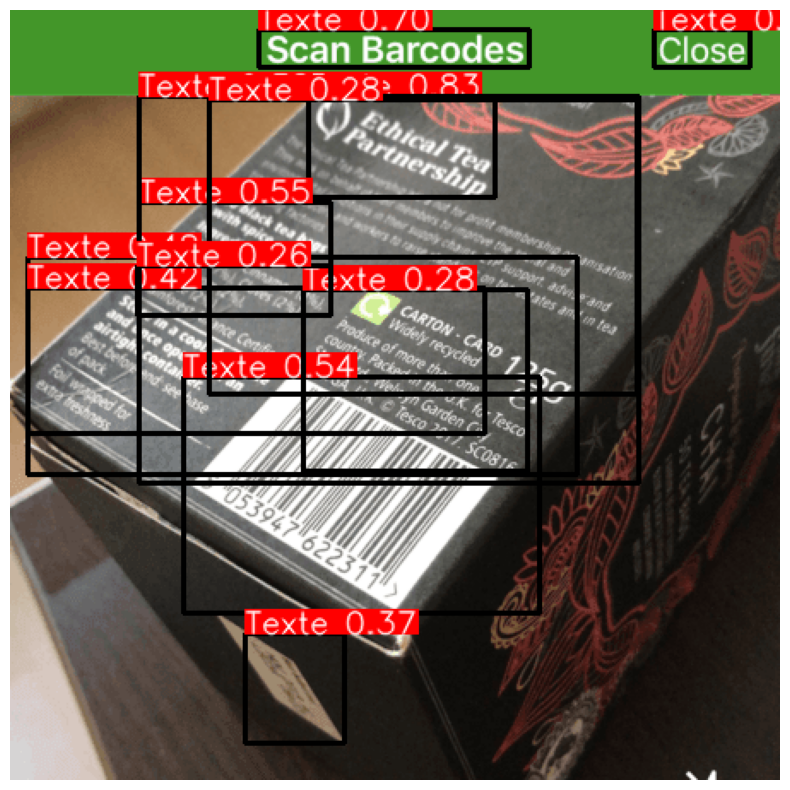





Affichage de la detection de forme par SAM




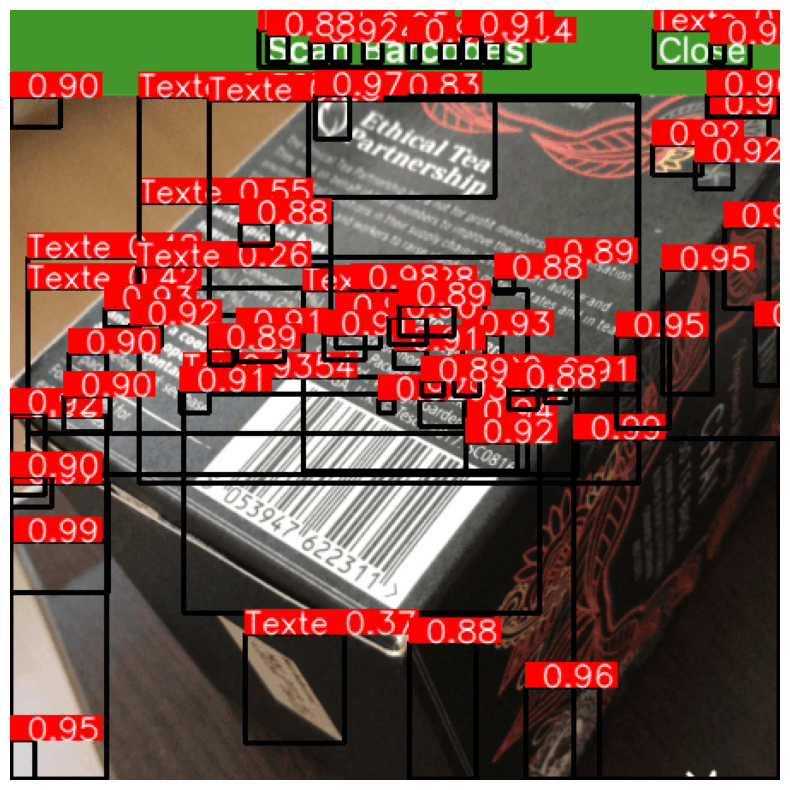

In [ ]:
inference(image_files, custom_image_dir)